%config Completer.use_jedi = False

### Common imports

In [2]:
%matplotlib inline
import os
import sys
import glob
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from PIL import Image
from imageio import imread, imsave
import cv2

## Question 1 Light source direction

The 3D coordinates of light source location $L=(x_l,y_l,z_l)$, the specular highlights, $S=(x_s,y_s,z_s)$ and the sphere center $C=(x_c,y_c,z_c)$ form one line.

The normal direction at specular highlights is $S-C = (x_s-x_c,y_s-y_c,z_s-z_c)$

$z_s = z_c - \sqrt{r^2 - (x_s-x_c)^2 - (y_s-y_c)^2}$ as $z_s$ is always smaller than $z_c$ based on camera coordinate system.

The normal direction is $ N = (x_s-x_c,y_s-y_c,- \sqrt{r^2 - (x_s-x_c)^2 - (y_s-y_c)^2}) $ by knowing $x_s,x_c,y_s,y_c,r$

The light source direction is the viewer direction (camera to specular highlights)'s $v = (0,0,1)$ reflection from the normal.

$ L = v - 2(v \cdot N)N$

$ L = [2(x_s-x_c)\sqrt{r^2 - (x_s-x_c)^2 - (y_s-y_c)^2},  2(y_s-y_c)\sqrt{r^2 - (x_s-x_c)^2 - (y_s-y_c)^2}, 1- (r^2 - (x_s-x_c)^2 - (y_s-y_c)^2) ]$





# Photometric Stereo

In [3]:
def LoadFaceImages(pathname, subject_name, num_images):
    """
    Load the set of face images.  
    The routine returns
        ambimage: image illuminated under the ambient lighting
        imarray: a 3-D array of images, h x w x Nimages
        lightdirs: Nimages x 3 array of light source directions
    """

    def load_image(fname):
        return np.asarray(Image.open(fname))

    def fname_to_ang(fname):
        yale_name = os.path.basename(fname)
        return int(yale_name[12:16]), int(yale_name[17:20])

    def sph2cart(az, el, r):
        rcos_theta = r * np.cos(el)
        x = rcos_theta * np.cos(az)
        y = rcos_theta * np.sin(az)
        z = r * np.sin(el)
        return x, y, z

    ambimage = load_image(
        os.path.join(pathname, subject_name + '_P00_Ambient.pgm'))
    im_list = glob.glob(os.path.join(pathname, subject_name + '_P00A*.pgm'))
    if num_images <= len(im_list):
        im_sub_list = np.random.choice(im_list, num_images, replace=False)
    else:
        print(
            'Total available images is less than specified.\nProceeding with %d images.\n'
            % len(im_list))
        im_sub_list = im_list
    im_sub_list.sort()
    imarray = np.stack([load_image(fname) for fname in im_sub_list], axis=-1)
    Ang = np.array([fname_to_ang(fname) for fname in im_sub_list])

    x, y, z = sph2cart(Ang[:, 0] / 180.0 * np.pi, Ang[:, 1] / 180.0 * np.pi, 1)
    lightdirs = np.stack([y, z, x], axis=-1)
    return ambimage, imarray, lightdirs

def plot_normal_map(normal_map):
    normal_viz = normal_map[:, ::, :]

    normal_viz = normal_viz + np.equal(np.sum(normal_viz, 2, 
    keepdims=True), 0.).astype(np.float32)*np.min(normal_viz)

    normal_viz = (normal_viz - np.min(normal_viz))/2.
    plt.axis('off')
    plt.imshow(normal_viz)

In [4]:
def save_outputs(subject_name, albedo_image, surface_normals):
    im = Image.fromarray((albedo_image*255).astype(np.uint8))
    im.save("%s_albedo.jpg" % subject_name)
    im = Image.fromarray((surface_normals[:,:,0]*128+128).astype(np.uint8))
    im.save("%s_normals_x.jpg" % subject_name)
    im = Image.fromarray((surface_normals[:,:,1]*128+128).astype(np.uint8))
    im.save("%s_normals_y.jpg" % subject_name)
    im = Image.fromarray((surface_normals[:,:,2]*128+128).astype(np.uint8))
    im.save("%s_normals_z.jpg" % subject_name)

#### Plot the albedo and the surface norms. 

In [5]:
def plot_albedo_and_surface_normals(albedo_image, surface_normals):
    """
    albedo_image: h x w matrix
    surface_normals: h x w x 3 matrix.
    """
    fig, axes = plt.subplots(1, 4, figsize=(10,2.5))
    ax = axes[0]
    ax.axis('off')
    ax.set_title('albedo')
    ax.imshow(albedo_image, cmap='gray')

    ax = axes[1]
    ax.axis('off')
    ax.set_title('X')
    im = ax.imshow(surface_normals[:,:,0], cmap='jet')
    ax = axes[2]
    ax.axis('off')
    ax.set_title('Y')
    im = ax.imshow(surface_normals[:,:,1], cmap='jet')
    ax = axes[3]
    ax.axis('off')
    ax.set_title('Z')
    im = ax.imshow(surface_normals[:,:,2], cmap='jet')

    fig.colorbar(im, ax=axes, fraction=0.02, aspect=15)

#### Plot the height map

In [6]:
def set_aspect_equal_3d(ax):
    """https://stackoverflow.com/questions/13685386"""
    """Fix equal aspect bug for 3D plots."""
    xlim = ax.get_xlim3d()
    ylim = ax.get_ylim3d()
    zlim = ax.get_zlim3d()
    from numpy import mean
    xmean = mean(xlim)
    ymean = mean(ylim)
    zmean = mean(zlim)
    plot_radius = max([
        abs(lim - mean_)
        for lims, mean_ in ((xlim, xmean), (ylim, ymean), (zlim, zmean))
        for lim in lims
    ])
    ax.set_xlim3d([xmean - plot_radius, xmean + plot_radius])
    ax.set_ylim3d([ymean - plot_radius, ymean + plot_radius])
    ax.set_zlim3d([zmean - plot_radius, zmean + plot_radius])

def display_3d(albedo_image, height_map, elev=20, azim=20):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.gca(projection='3d')
    ax.view_init(elev, azim)
    X = np.arange(albedo_image.shape[0])
    Y = np.arange(albedo_image.shape[1])
    X, Y = np.meshgrid(Y, X)
    H = np.flipud(np.fliplr(height_map))
    A = np.flipud(np.fliplr(albedo_image))
    A = np.stack([A, A, A], axis=-1)
    ax.xaxis.set_ticks([])
    ax.xaxis.set_label_text('Z')
    ax.yaxis.set_ticks([])
    ax.yaxis.set_label_text('X')
    ax.zaxis.set_ticks([])
    ax.yaxis.set_label_text('Y')
    surf = ax.plot_surface(
        H, X, Y, cmap='gray', facecolors=A, linewidth=0, antialiased=False)
    set_aspect_equal_3d(ax)

---
### Your implementation

In [175]:
def preprocess(ambimage, imarray):
    """
    preprocess the data: 
        1. subtract ambient_image from each image in imarray.
        2. make sure no pixel is less than zero.
        3. rescale values in imarray to be between 0 and 1.
    Inputs:
        ambimage: h x w
        imarray: h x w x Nimages
    Outputs:
        processed_imarray: h x w x Nimages
    """
    offset =imarray - np.expand_dims(mbimage, axis=-1)
    offset = offset / 255
    offset = np.clip(offset,0,1)
    return offset

In [95]:
def photometric_stereo(imarray, light_dirs):
    """
    Inputs:
        imarray:  h x w x Nimages
        light_dirs: Nimages x 3
    Outputs:
        albedo_image: h x w
        surface_norms: h x w x 3
    """
    albedo_image = np.zeros(imarray.shape[:2])
    shape = list(imarray.shape[:2])
    shape.append(3)
    surface_norms = np.zeros(shape)
    
    light_dirs_sq_inv = np.linalg.inv(light_dirs.T.dot(light_dirs))
    for i in range(imarray.shape[0]):
        for j in range(imarray.shape[1]):
            G = light_dirs_sq_inv.dot( np.expand_dims( light_dirs.T.dot(imarray[i,j]) ,-1)  )
            albedo_image[i,j] = np.linalg.norm(G)
            surface_norms[i,j] = (G/np.linalg.norm(G)).reshape(-1)
    return albedo_image, surface_norms

In [139]:
def get_surface(surface_normals):
    """
    Inputs:
        surface_normals:h x w x 3
    Outputs:
        height_map: h x w
    """
    height_map = np.zeros(surface_normals.shape[:2])
    
    p_derive = surface_normals/ np.expand_dims(surface_normals[:,:,-1],-1)
    
           
#     """The following is wrong, basically I switch up the fx and fy for integration"""
#     for i in range(height_map.shape[0]):
#         for j in range(height_map.shape[1]):
#             p1 = p_derive[:i+1,0,0].sum() + p_derive[i,:j+1,1].sum()
#             p2 = p_derive[0,:j+1,1].sum() + p_derive[:i+1,j,0].sum()
#             height_map[i,j] = (p1+p2)/2       
            
            
    """The following is correct"""
    for i in range(height_map.shape[0]):
        for j in range(height_map.shape[1]):
            p1 = p_derive[:i+1,0,1].sum() + p_derive[i,:j+1,0].sum()
            p2 = p_derive[0,:j+1,0].sum() + p_derive[:i+1,j,1].sum()
            height_map[i,j] = (p1+p2)/2        
            
            
            
            
            
            
#     for i in range(1,height_map.shape[0]):
#         height_map[i,0]=p_derive[:i+1,0,1].sum()
#     for j in range(1,height_map.shape[1]):
#         height_map[0,j]=p_derive[0,:j+1,0].sum()
  

    
#     for i in range(1,height_map.shape[0]):
#         for j in range(1,height_map.shape[1]):
#             height_map[i,j] = (height_map[i-1,j]+p_derive[i-1,j,1]+height_map[i,j-1]+p_derive[i,j-1,0])/2
    
#     for i in range(height_map.shape[0]):
#         for j in range(height_map.shape[1]):
#             p1 = p_derive[:i+1,0,1].sum() + p_derive[i,:j+1,0].sum()
#             p2 = p_derive[0,:j+1,0].sum() + p_derive[:i+1,j,1].sum()
            
#             height_map[i,j] = (p1+p2)/2
            
    return height_map

### Main function

## Problem 2

In [76]:
pathname = "/home/chingyuenliu/TTIC_ComputerVision/PS3/data/croppedyale/yaleB02"
subject_name = "yaleB02"
num_images = 64
ambimage, imarray, lightdirs = LoadFaceImages(pathname, subject_name, num_images)

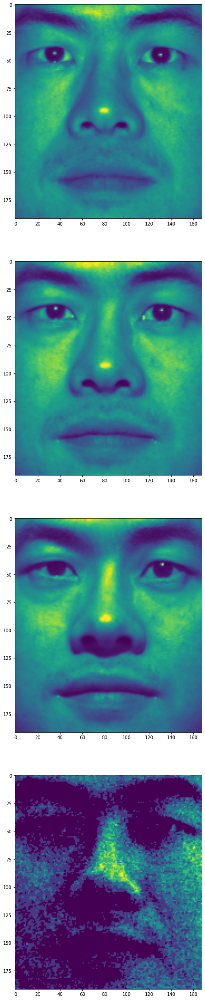

In [77]:
fig = plt.figure(figsize=(10, 40))

for i in range(3):
    ax = fig.add_subplot(4,1,i+1)
    im = ax.imshow(imarray[:,:,i])

ax = fig.add_subplot(4,1,4)
im =ax.imshow(ambimage)
plt.show()

## Answer to problem 2

Shadow would form if there is blockage. Edges, closer to light source almost always brighter

## Problem 4

In [78]:
root_pathname = "./data/croppedyale/"
subject_name_list = ["yaleB01","yaleB02","yaleB05","yaleB07"]

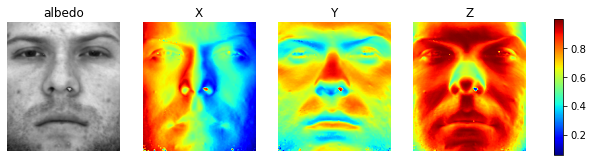

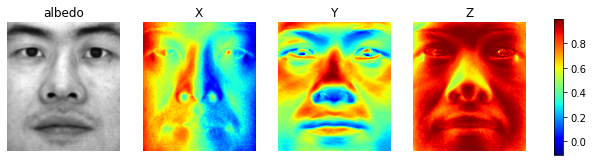

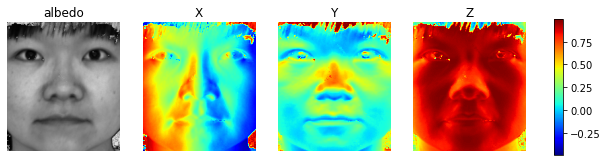

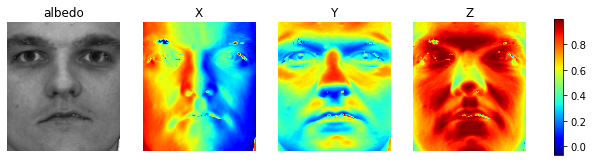

In [115]:
for subject_name in subject_name_list:
    full_path = os.path.join(root_pathname,subject_name)
    ambient_image, imarray, light_dirs = LoadFaceImages(full_path, subject_name, 64)
    
    processed_imarray = preprocess(ambient_image, imarray)
    albedo_image, surface_normals = photometric_stereo(processed_imarray,
                                                   light_dirs)
    plot_albedo_and_surface_normals(albedo_image, surface_normals)
    

## Problem 5

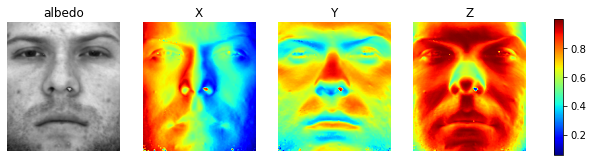

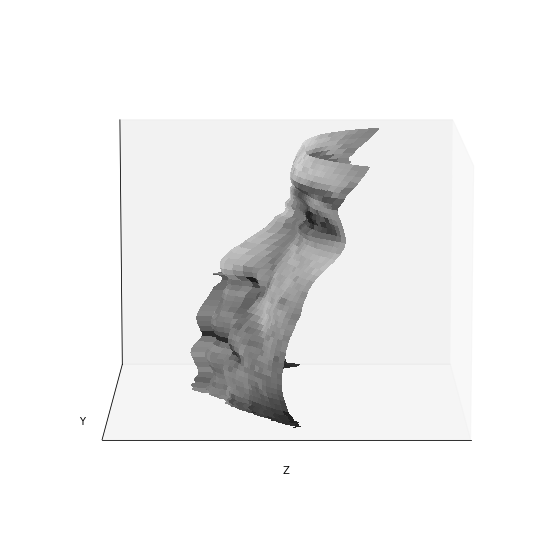

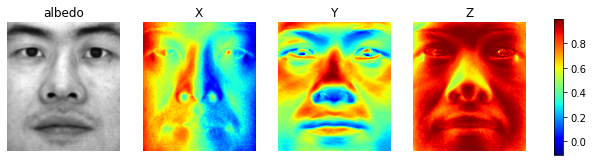

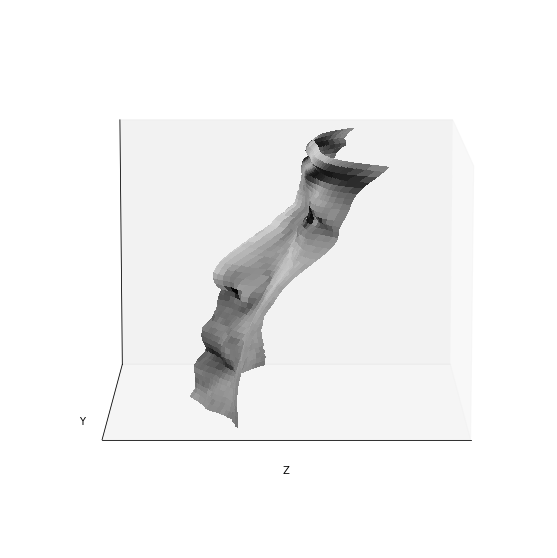

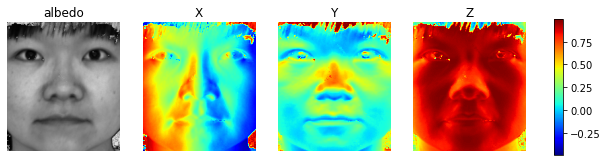

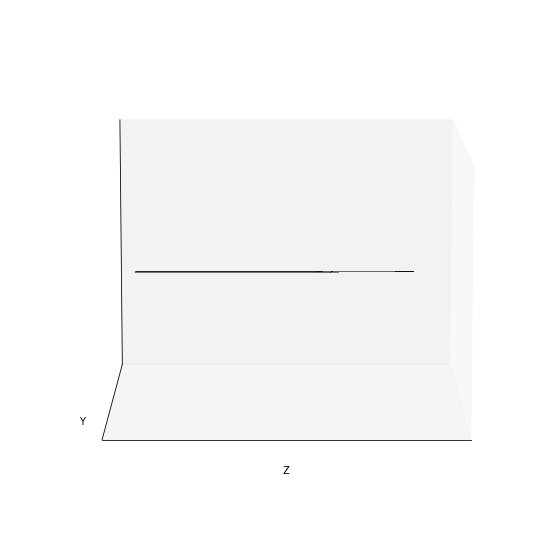

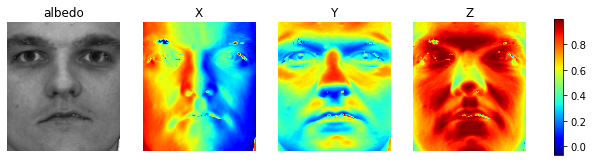

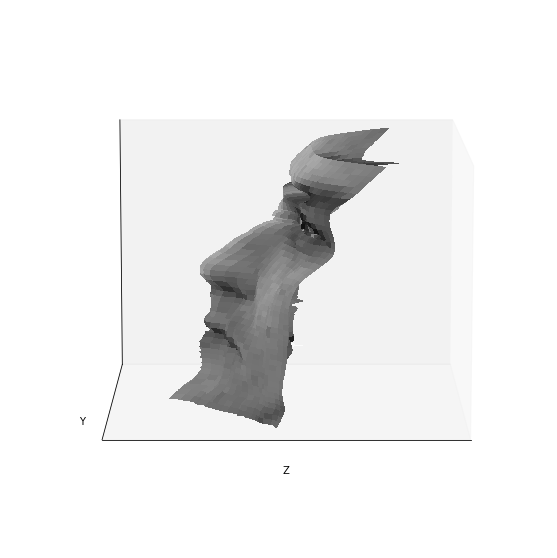

In [176]:
for subject_name in subject_name_list:
    full_path = os.path.join(root_pathname,subject_name)
    ambient_image, imarray, light_dirs = LoadFaceImages(full_path, subject_name, 64)
    
    processed_imarray = preprocess(ambient_image, imarray)
    albedo_image, surface_normals = photometric_stereo(processed_imarray,
                                                   light_dirs)
    plot_albedo_and_surface_normals(albedo_image, surface_normals)
    height_map = get_surface(surface_normals)


    display_3d(albedo_image, height_map, elev=10, azim=90)
    

## Problem 6

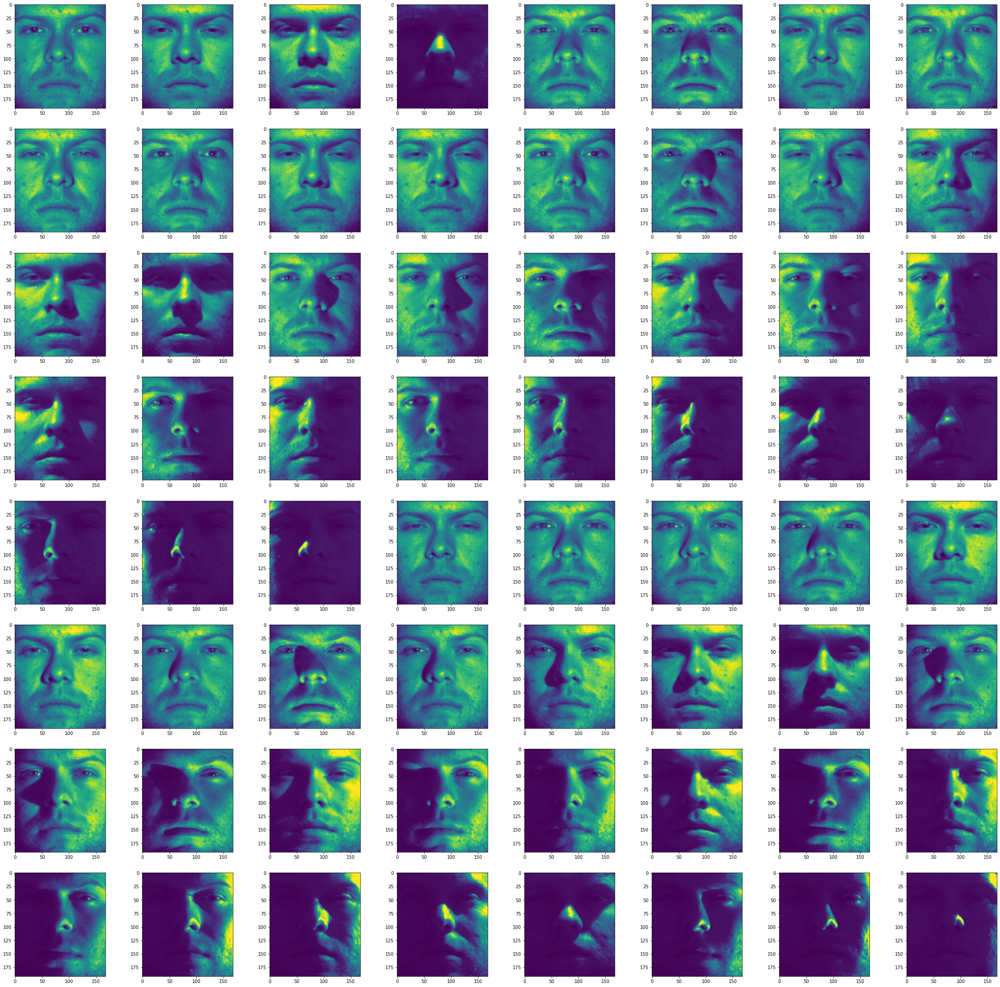

In [169]:
for subject_name in subject_name_list[0:10:10]:
    full_path = os.path.join(root_pathname,subject_name)
    ambient_image, imarray, light_dirs = LoadFaceImages(full_path, subject_name, 64)

    fig = plt.figure(figsize=(40, 40))

    for i in range(64):
        ax = fig.add_subplot(8,8,i+1)
        im = ax.imshow(imarray[:,:,i])

    plt.show()




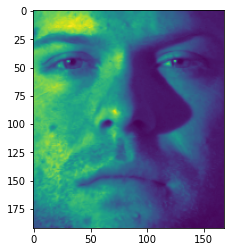

In [170]:
plt.imshow(imarray[:,:,19])

## Answer to Problem 6

The photometric stereo only works when there is no shadow. For subject yaleB01, as shown above, the hair caused shadows on the face, resulting the intensity of the pixles is not corresponding to the actually normal. 

In [171]:
new_imarray=imarray[:,:,np.r_[0:12,26:42,52:]]

In [172]:
new_light_dirs = light_dirs[np.r_[0:12,26:42,52:],:]

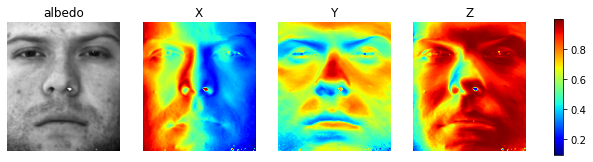

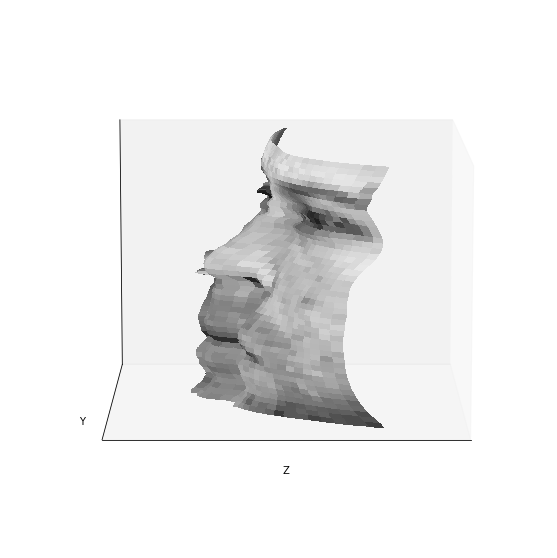

In [173]:
processed_imarray = preprocess(ambient_image, new_imarray)
albedo_image, surface_normals = photometric_stereo(processed_imarray,
                                               new_light_dirs)
plot_albedo_and_surface_normals(albedo_image, surface_normals)
height_map = get_surface(surface_normals)


display_3d(albedo_image, height_map, elev=10, azim=90)

## Answer to Problem 6 continued

After removing the one with shadows in it, qualitatively, I did not see any improvement. However, due to reduced sample size, the 3D plot does become less smooth where each mosaic block size increased.

# Test

/Users/igorvasiljevic/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  


'\nif save_flag:\n    save_outputs(subject_name, albedo_image, surface_normals)\n'

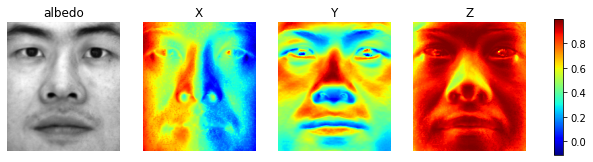

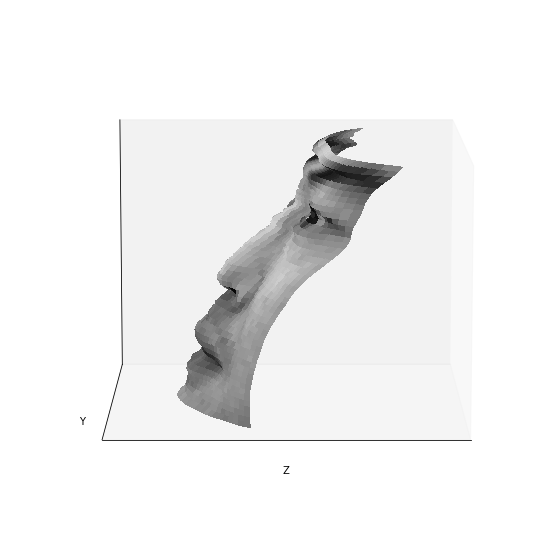

In [9]:
root_path = './croppedyale/'
subject_name = 'yaleB02'

integration_method = 'average'
save_flag = True

full_path = '%s%s' % (root_path, subject_name)
ambient_image, imarray, light_dirs = LoadFaceImages(full_path, subject_name,
                                                    64)


processed_imarray = preprocess(ambient_image, imarray)

albedo_image, surface_normals = photometric_stereo(processed_imarray,
                                                   light_dirs)


height_map = get_surface(surface_normals)

plot_albedo_and_surface_normals(albedo_image, surface_normals)
display_3d(albedo_image, height_map, elev=10, azim=90)
"""
if save_flag:
    save_outputs(subject_name, albedo_image, surface_normals)
"""

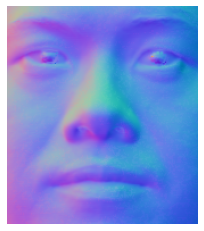

In [10]:
plot_normal_map(surface_normals)

# Denoising

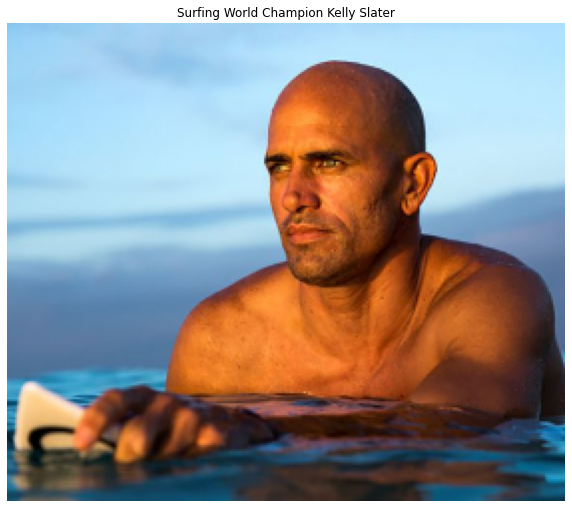

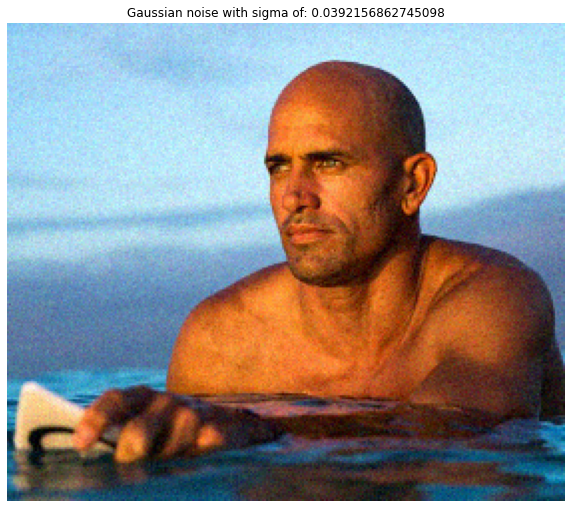

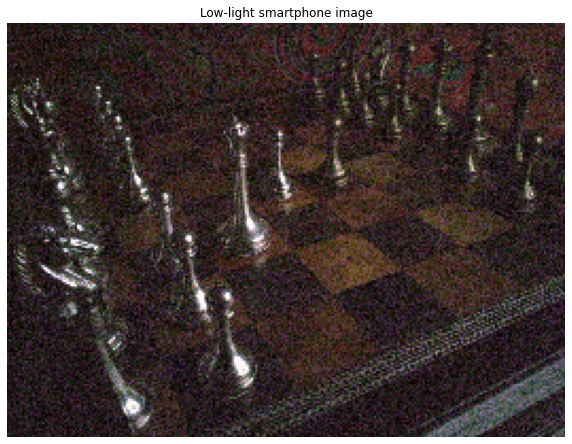

In [177]:
slater_image = imread('data/slater.jpg')/255.

# Note: we are reducing the size for faster processing.
slater_image = cv2.resize(slater_image, (280, 240))

sigma = 10/255.

plt.figure(figsize=(10,20))
plt.axis('off')
plt.imshow(slater_image)

def noising_model(image, sigma):
    noise = np.random.normal(0, sigma, (image.shape))
    return image + noise

noisy_image = noising_model(slater_image, sigma=sigma)

# need to bring us better into range
noisy_image = np.clip(noisy_image, 0, 1)

plt.title("Surfing World Champion Kelly Slater")
plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Gaussian noise with sigma of: {}".format(sigma))
plt.imshow(noisy_image)

# "real" noise image
chess_raw = imread("data/chess.png")

chess_noisy = cv2.resize(chess_raw, (int(chess_raw.shape[1]/4), int(chess_raw.shape[0]/4)))/255.
plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Low-light smartphone image")
plt.imshow(chess_noisy)

In [178]:
chess_noisy.shape

(195, 263, 3)

In [191]:
import scipy as sp
import scipy.signal as sps

In [206]:
# Implement the two filters from scratch

def median_filter(data, filter_size):
    """
    data = h*w*d

    """
    
    denoised_data = np.zeros(data.shape)
    
    for d in range(denoised_data.shape[-1]):
        denoised_data[:,:,d] = sp.ndimage.median_filter(data[:,:,d], size=[filter_size,filter_size], mode='reflect')
    return denoised_data

def mean_filter(data, filter_size):
    """
    data = h*w*d

    """
    
    denoised_data = np.zeros(data.shape)
    kernel = np.ones([filter_size,filter_size])
    kernel /= kernel.sum()
    for d in range(denoised_data.shape[-1]):
        denoised_data[:,:,d] = sps.convolve2d(data[:,:,d],kernel,mode='same',boundary='symm')
    return denoised_data

## Problem 7

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


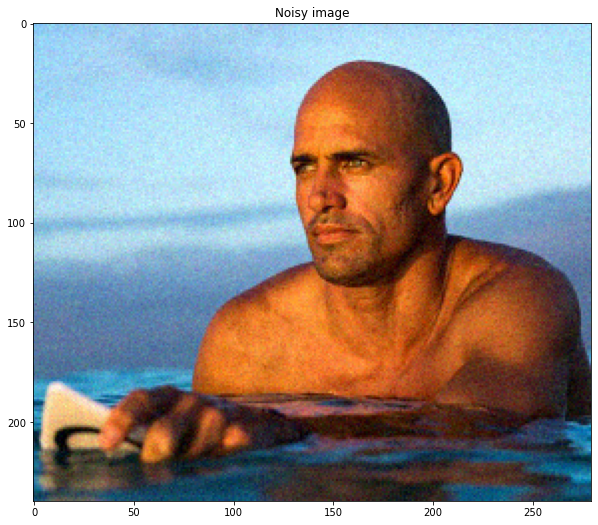

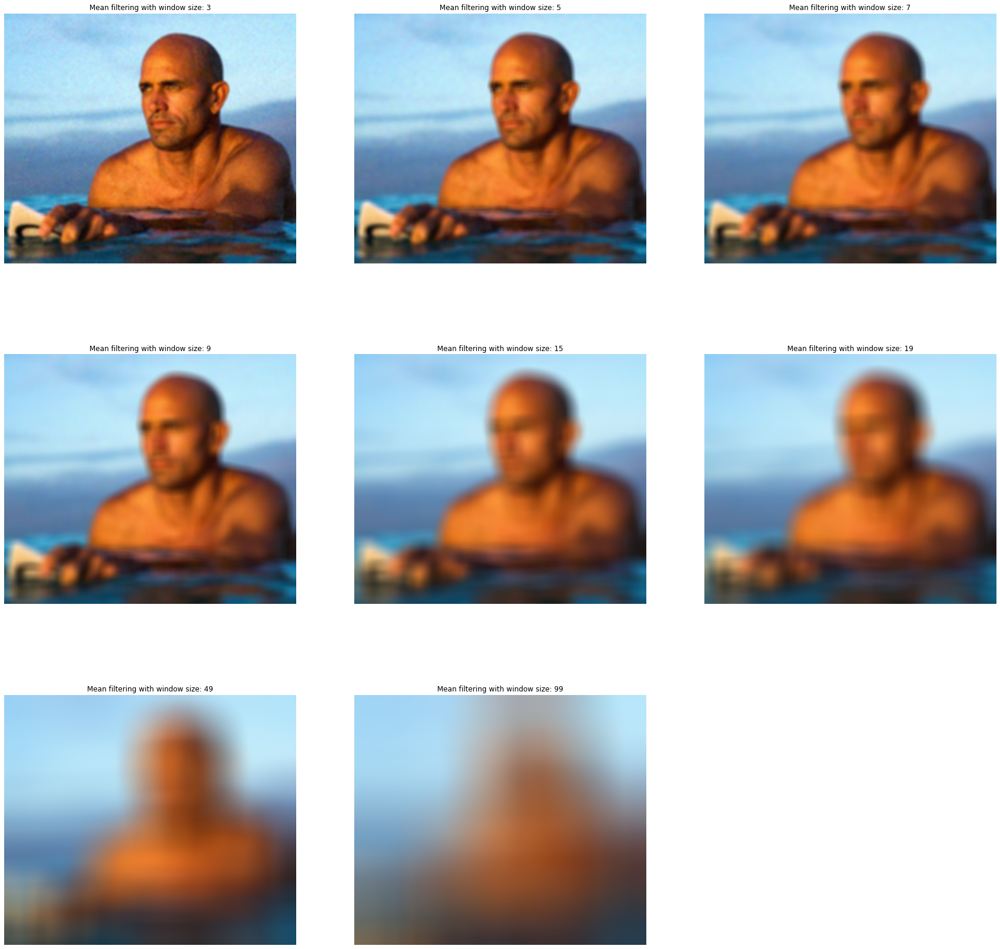

In [199]:
window_size_list = [3,5,7,9,15,19,49,99]

plt.figure(figsize=(10,20))
plt.title("Noisy image")
plt.imshow(noisy_image)

fig = plt.figure(figsize=(30, 30))

for i in range(len(window_size_list)):
    ax = fig.add_subplot(3,3,i+1)
    window_size = window_size_list[i]
    mean_filtered_image = mean_filter(noisy_image, window_size)
    ax.axis('off')
    ax.set_title("Mean filtering with window size: {}".format(window_size))
    im = ax.imshow(mean_filtered_image)

plt.show()

# mean_filtered_image = mean_filter(noisy_image, window_size)
# # median_filtered_image = median_filter(noisy_image, window_size)

# plt.figure(figsize=(10,20))
# plt.title("Noisy image")
# plt.imshow(noisy_image)
# plt.axis('off')
# plt.figure(figsize=(10,20))
# plt.axis('off')
# plt.title("Mean filtering with window size: {}".format(window_size))
# plt.imshow(mean_filtered_image)
# # plt.figure(figsize=(10,20))
# # plt.axis('off')
# # plt.title("Median filtering with window size: {}".format(window_size))
# # plt.imshow(median_filtered_image)

## Answer to Problem 7

As kernel size increased, the noise is smoothed out, however information is lost when the filter size increased. It gets really hard to pinpoint edges of the images. Additionally, when filter size increased, the ringing effects is also more noticeable.

## Problem 8

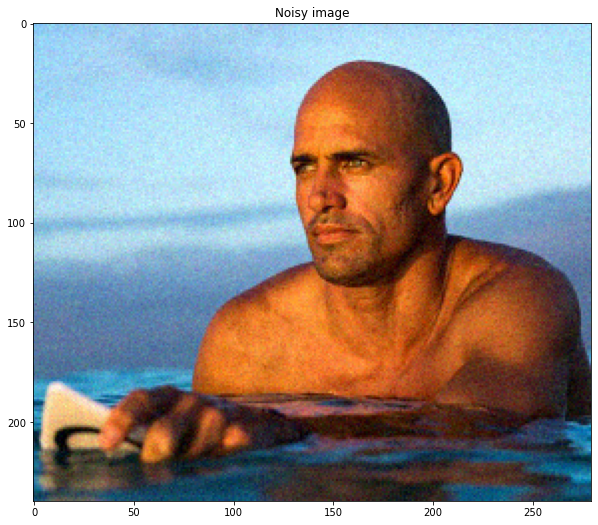

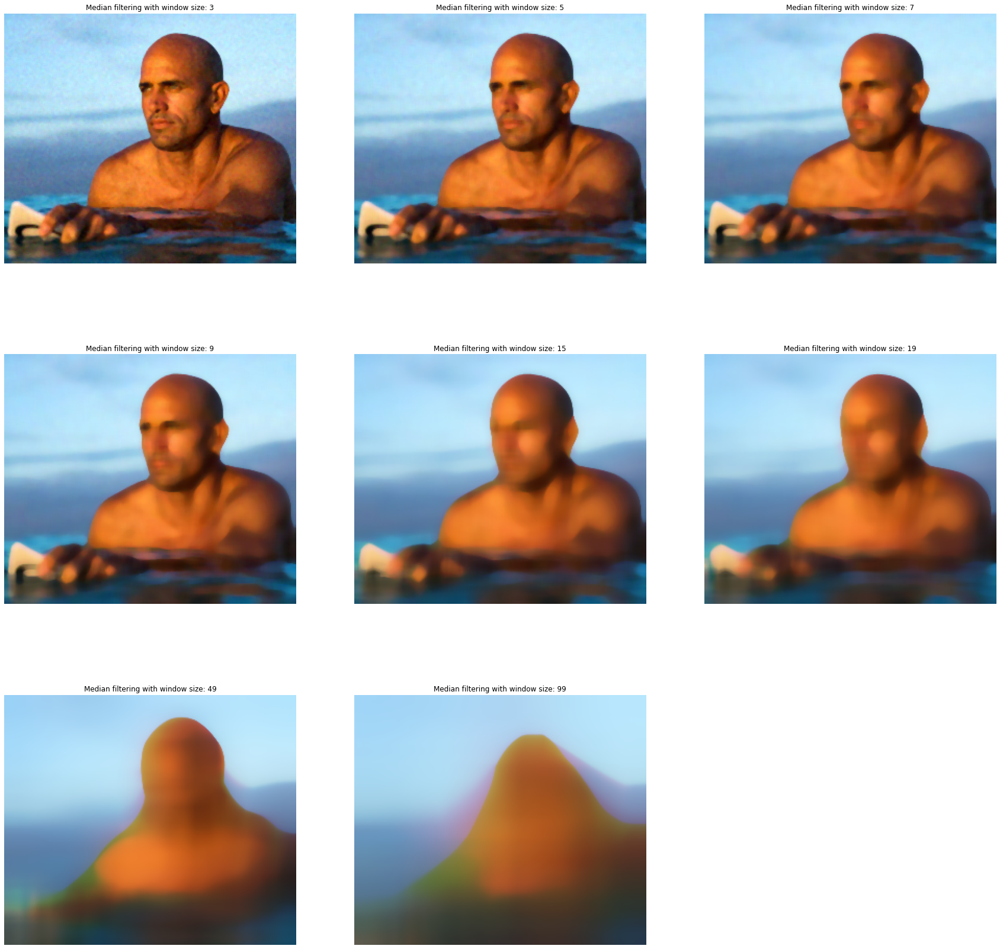

In [207]:
window_size_list = [3,5,7,9,15,19,49,99]

plt.figure(figsize=(10,20))
plt.title("Noisy image")
plt.imshow(noisy_image)

fig = plt.figure(figsize=(30, 30))

for i in range(len(window_size_list)):
    ax = fig.add_subplot(3,3,i+1)
    window_size = window_size_list[i]
    median_filtered_image = median_filter(noisy_image, window_size)
    ax.axis('off')
    ax.set_title("Median filtering with window size: {}".format(window_size))
    im = ax.imshow(median_filtered_image)

plt.show()

# mean_filtered_image = mean_filter(noisy_image, window_size)
# # median_filtered_image = median_filter(noisy_image, window_size)

# plt.figure(figsize=(10,20))
# plt.title("Noisy image")
# plt.imshow(noisy_image)
# plt.axis('off')
# plt.figure(figsize=(10,20))
# plt.axis('off')
# plt.title("Mean filtering with window size: {}".format(window_size))
# plt.imshow(mean_filtered_image)
# # plt.figure(figsize=(10,20))
# # plt.axis('off')
# # plt.title("Median filtering with window size: {}".format(window_size))
# # plt.imshow(median_filtered_image)

## Answer to Problem 8

SImilar trade off happened when the window size / filter size increased, the noise is smoothed out but more information is lost. However, median filter did better than mean filter as it really captures the human and environment and is able to seperate them out. Additionally, ring effect is mitigated. I will say median filter better capture the details information than mean filter. 


In [208]:
def psnr(noisy_image, denoised_image):
    error = mse(noisy_image,denoised_image)
    psnr_value = 20 * np.log10(1/(error**0.5))
    return psnr_value

def mse(noisy_image, denoised_image):
    error = ((noisy_image - denoised_image)**2).mean(axis=None)
    return error

## Problem 9

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


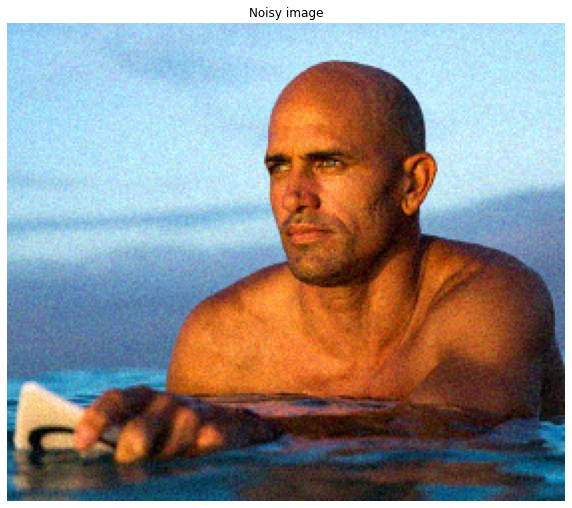

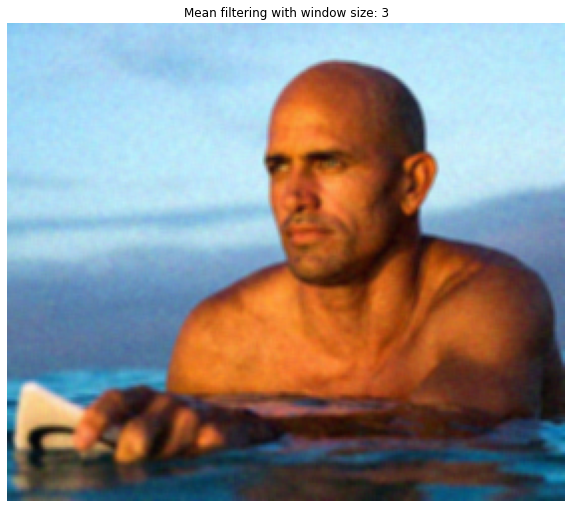

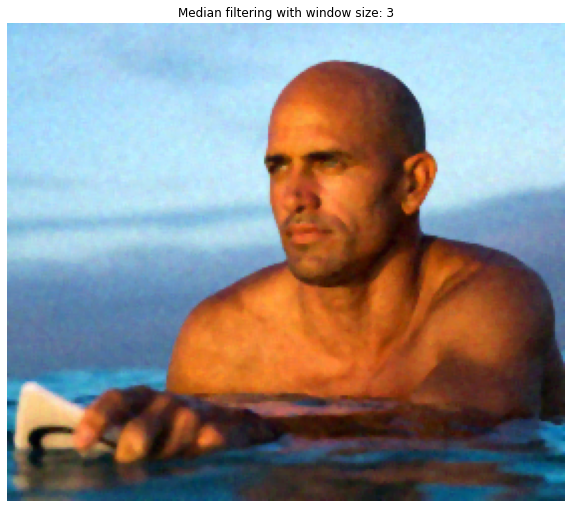

In [343]:
window_size = 3

mean_filtered_image = mean_filter(noisy_image, window_size)
median_filtered_image = median_filter(noisy_image, window_size)

plt.figure(figsize=(10,20))
plt.title("Noisy image")
plt.imshow(noisy_image)
plt.axis('off')
plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Mean filtering with window size: {}".format(window_size))
plt.imshow(mean_filtered_image)
plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Median filtering with window size: {}".format(window_size))
plt.imshow(median_filtered_image)

In [344]:
print("PSNR for the noisy image: {}".format(psnr(slater_image, noisy_image)))
print("PSNR for the mean filtered image: {}".format(psnr(slater_image, mean_filtered_image)))
print("PSNR for the median filtered image: {}".format(psnr(slater_image, median_filtered_image)))

PSNR for the noisy image: 28.376482635278883
PSNR for the mean filtered image: 32.26504711126587
PSNR for the median filtered image: 32.892818108761595


In [345]:
print("MSE for the noisy image: {}".format(mse(slater_image, noisy_image)))
print("MSE for the mean filtered image: {}".format(mse(slater_image, mean_filtered_image)))
print("MSE for the median filtered image: {}".format(mse(slater_image, median_filtered_image)))

MSE for the noisy image: 0.0014532881637515612
MSE for the mean filtered image: 0.0005936019088995535
MSE for the median filtered image: 0.0005137102001855639


## Answer to Problem 9

Yes, it does fit my objective. Median filter performed best with PSNR of 32.26 and mean filter performed second with PSNR 32.89. The worse image is the one without any denoising technique, and the PSNR value is 28.38

## Problem 10 & Problem 11

In [335]:
def compute_weight(d, h=1, sigma=20/255.):
    diff_sq = d**2
    tau = sigma/h
    
    return np.exp(-diff_sq/(tau**2))#/(2*np.pi*tau**2)

def bilateral_filter(image, sigma=None, h=None):
    # hint for "naive" for-loop based implementation
    n1, n2, c = image.shape

    Z = np.zeros((n1, n2, *[1] * (image.ndim - 2)))
    x = np.zeros(image.shape)

    s1 = s2 = 2 # search window domain
    p1 = p2 = 1 # patch domain; patch size is (2p1 + 1) x (2p2 + 1)
    #tau position = 2, distance between two positions is less than will be considered, 
    padded_image = np.pad(image,((s1,s1),(s2,s2),(0,0)), 'reflect')
    for i in range(s1, n1+s1):
        for j in range(s2, n2+s2):
            filter_matrix = np.zeros([2*s1+1,2*s2+1,c])
            for k in range(-s1, s1 + 1):
                for l in range(-s2, s2 + 1):
                    diff = padded_image[i,j]-padded_image[i+k,j+l]
                    filter_matrix[k+s1,l+s2] = compute_weight(diff,h=1,sigma=sigma)
            filter_matrix /= filter_matrix.sum(axis=(0,1))
            x[i-s1,j-s2] = (padded_image[i-s1:i+s1+1,j-s2:j+s2+1]*filter_matrix).sum(axis=(0,1))
    return x

0.0 9.901354551315308
PSNR for the bilateral filtered image: 33.2355427520725


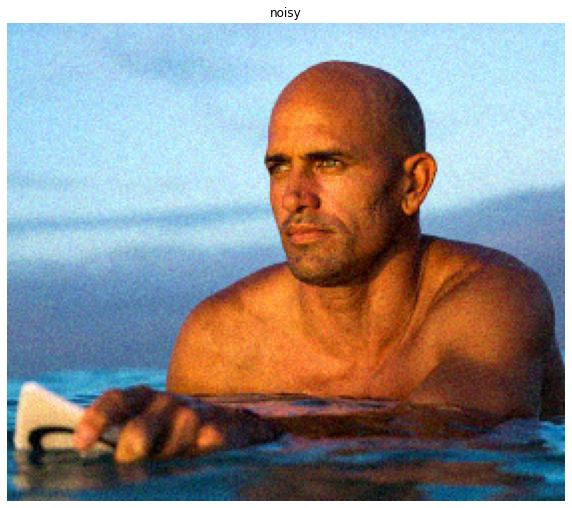

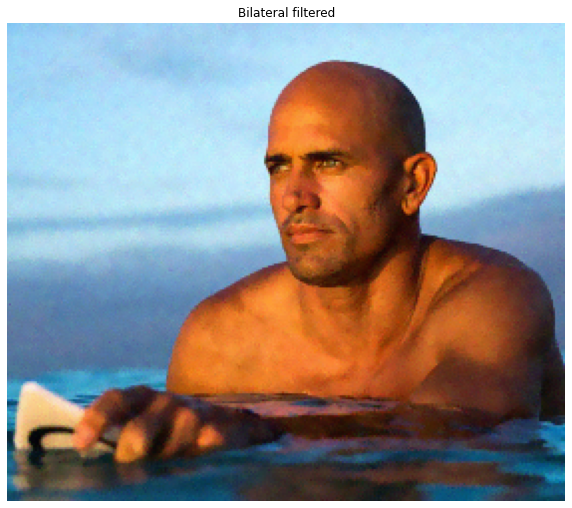

In [341]:
import time

start = time.time()

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("noisy")
plt.imshow(noisy_image)

bilateral_filtered_image = bilateral_filter(noisy_image, sigma=20/255.)
# nlmeans_filtered_image = nlmeans_filter(noisy_image, sigma=10/255.)

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Bilateral filtered")
plt.imshow(bilateral_filtered_image)

# plt.figure(figsize=(10,20))
# plt.axis('off')
# plt.title("NLM filtered")
# plt.imshow(nlmeans_filtered_image)

elapsed = (time.time() - start)

hours, rem = divmod(elapsed, 3600)
minutes, seconds = divmod(rem, 60)
print(minutes, seconds)

# Note: your numbers can be different depending on implementation and hyperparameters
print("PSNR for the bilateral filtered image: {}".format(psnr(slater_image, bilateral_filtered_image)))
# print("PSNR for the NLM filtered image: {}".format(psnr(slater_image, nlmeans_filtered_image)))

In [340]:
# def compute_weight(d, h=1, sigma=20/255.):
#     diff_sq = d**2
#     tau = sigma/h
    
#     return np.exp(-diff_sq/tau**2)#/(2*np.pi*tau**2)


def nlmeans_filter(image, sigma=None, h=None):
    # hint: implementation will be very similar to bilateral filter, can reuse most of your implementation
    
    # hint for "naive" for-loop based implementation
    n1, n2, c = image.shape

    Z = np.zeros((n1, n2, *[1] * (image.ndim - 2)))
    x = np.zeros(image.shape)

    s1 = s2 = 5 # search window domain
    p1 = p2 = 2 # patch domain; patch size is (2p1 + 1) x (2p2 + 1)
    #tau position = 2, distance between two positions is less than will be considered, 
    padded_image = np.pad(image,((s1,s1),(s2,s2),(0,0)), 'reflect')
    for i in range(s1, n1+s1):
        for j in range(s2, n2+s2):
            filter_matrix = np.zeros([2*s1-2*p1+1,2*s2-2*p2+1,c])
            for k in range(-s1+p1, s1 + 1-p1):
                for l in range(-s2+p2, s2 + 1-p2):
                    center = padded_image[i-p1:i+p1+1,j-p2:j+p2+1]
                    patch = padded_image[i+k-p1:i+k+p1+1,j+l-p2:j+l+p2+1]
                    diff_sq = ((patch - center)**2).mean(axis=(0,1))
                    diff = diff_sq**0.5
                    filter_matrix[k+s1-p1,l+s2-p2] = compute_weight(diff,h=1,sigma=sigma)
            filter_matrix /= filter_matrix.sum(axis=(0,1))
            temp_output = np.zeros(filter_matrix.shape)
            for num1,k in enumerate(range(-s1+p1, s1 + 1-p1)):
                for num2,l in enumerate(range(-s2+p2, s2 + 1-p2)):
                    temp_output[num1,num2]=filter_matrix[num1,num2]*padded_image[i+k,j+l]
            x[i-s1,j-s2] = temp_output.sum(axis=(0,1))
    return x


3.0 50.74602174758911
PSNR for the NLM filtered image: 34.547169368372025


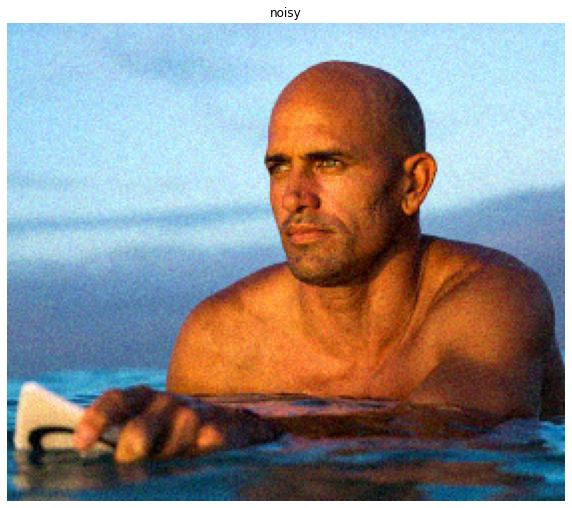

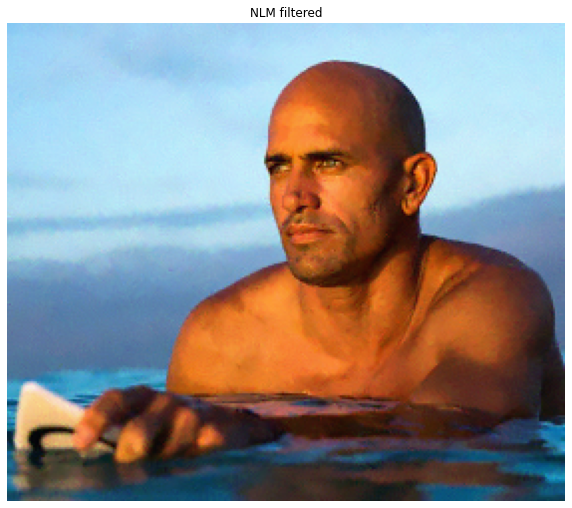

In [330]:
import time

start = time.time()

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("noisy")
plt.imshow(noisy_image)

#bilateral_filtered_image = bilateral_filter(noisy_image, sigma=10/255.)
nlmeans_filtered_image = nlmeans_filter(noisy_image, sigma=10/255.)

# plt.figure(figsize=(10,20))
# plt.axis('off')
# plt.title("Bilateral filtered")
# plt.imshow(bilateral_filtered_image)

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("NLM filtered")
plt.imshow(nlmeans_filtered_image)

elapsed = (time.time() - start)

hours, rem = divmod(elapsed, 3600)
minutes, seconds = divmod(rem, 60)
print(minutes, seconds)

# Note: your numbers can be different depending on implementation and hyperparameters
# print("PSNR for the bilateral filtered image: {}".format(psnr(slater_image, bilateral_filtered_image)))
print("PSNR for the NLM filtered image: {}".format(psnr(slater_image, nlmeans_filtered_image)))

1.0 27.44926142692566
PSNR for the bilateral filtered image: 33.2355427520725
PSNR for the NLM filtered image: 34.8040196761902


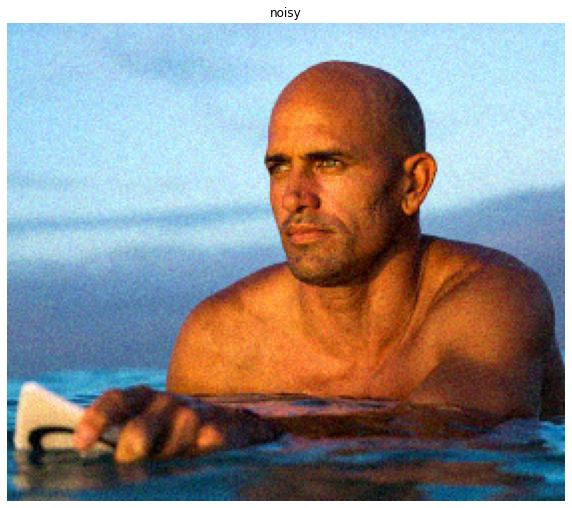

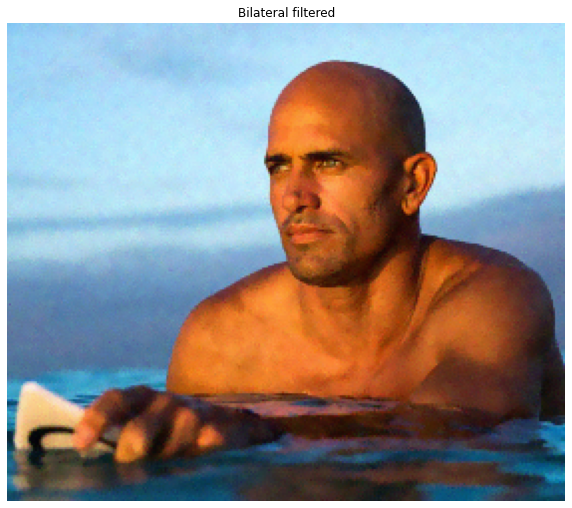

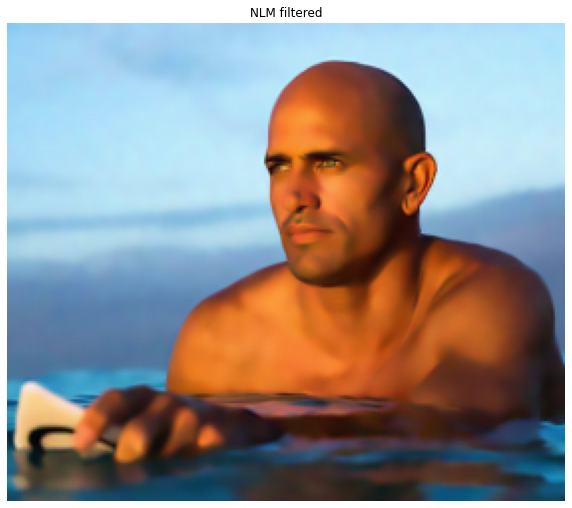

In [342]:
import time

start = time.time()

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("noisy")
plt.imshow(noisy_image)

bilateral_filtered_image = bilateral_filter(noisy_image, sigma=20/255.)
nlmeans_filtered_image = nlmeans_filter(noisy_image, sigma=20/255.)

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Bilateral filtered")
plt.imshow(bilateral_filtered_image)

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("NLM filtered")
plt.imshow(nlmeans_filtered_image)

elapsed = (time.time() - start)

hours, rem = divmod(elapsed, 3600)
minutes, seconds = divmod(rem, 60)
print(minutes, seconds)

# Note: your numbers can be different depending on implementation and hyperparameters
print("PSNR for the bilateral filtered image: {}".format(psnr(slater_image, bilateral_filtered_image)))
print("PSNR for the NLM filtered image: {}".format(psnr(slater_image, nlmeans_filtered_image)))

(240, 280, 3)
7.0 3.826629877090454
PSNR for the bilateral filtered image: 66.59952934319536
PSNR for the NLM filtered image: 66.55063526764336


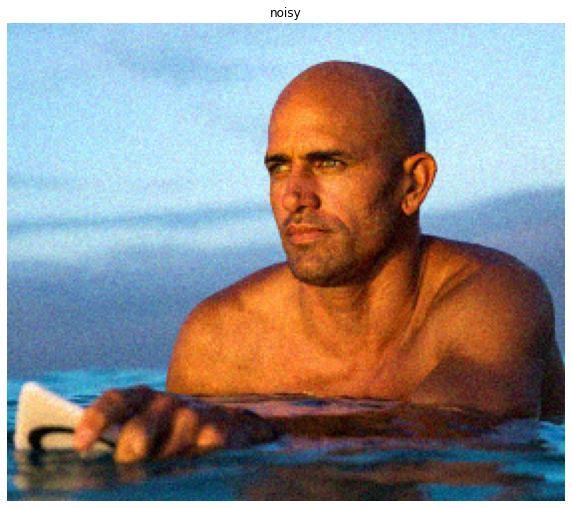

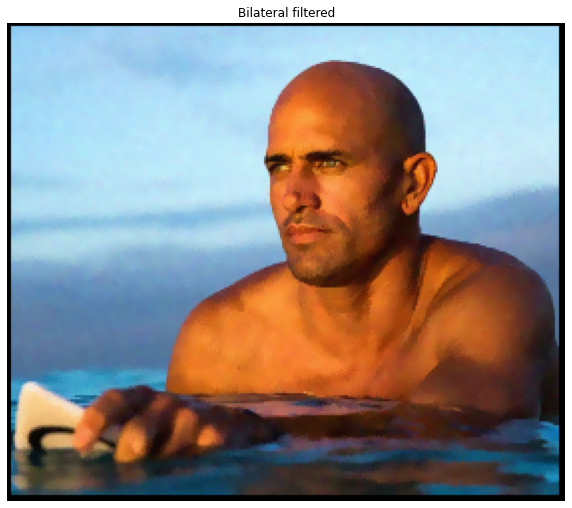

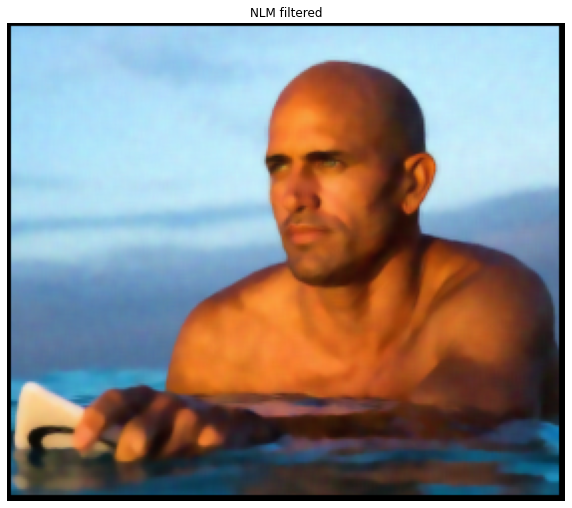

In [18]:
import time

start = time.time()

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("noisy")
plt.imshow(noisy_image)

bilateral_filtered_image = bilateral_filter(noisy_image, sigma=10/255.)
nlmeans_filtered_image = nlmeans_filter(noisy_image, sigma=10/255.)

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Bilateral filtered")
plt.imshow(bilateral_filtered_image)

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("NLM filtered")
plt.imshow(nlmeans_filtered_image)

elapsed = (time.time() - start)

hours, rem = divmod(elapsed, 3600)
minutes, seconds = divmod(rem, 60)
print(minutes, seconds)

# Note: your numbers can be different depending on implementation and hyperparameters
print("PSNR for the bilateral filtered image: {}".format(psnr(slater_image, bilateral_filtered_image)))
print("PSNR for the NLM filtered image: {}".format(psnr(slater_image, nlmeans_filtered_image)))

## Answer to Problem 10 and Problem 11

The PSNR value for Bilateral filter: 33.23
The PSNR value for NLM filter: 34.55
The PSNR value for median filter: 32.89

Based on the PSNR value bilateral filter and non-local means, both of the bilateral filter and NLM filter did better than median filter. Qualitatively speaking, the NLM filter denoised image is have the image more smoothed out and the bilateral filter keeps more edge information, better contrast.

Even the PSNR value is not as high as the one provided from the notebook (The example's PSNR is over 65), the denoised image viewed from eyes are very similar.

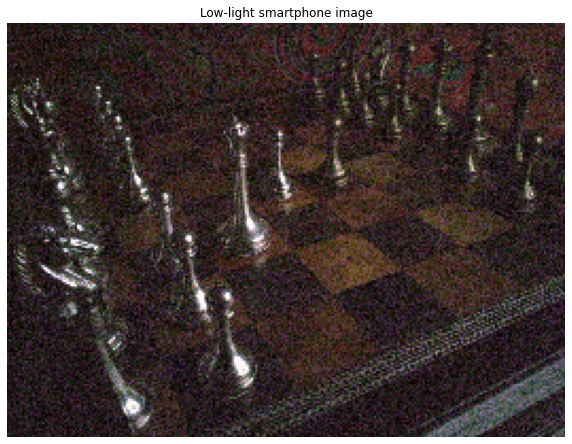

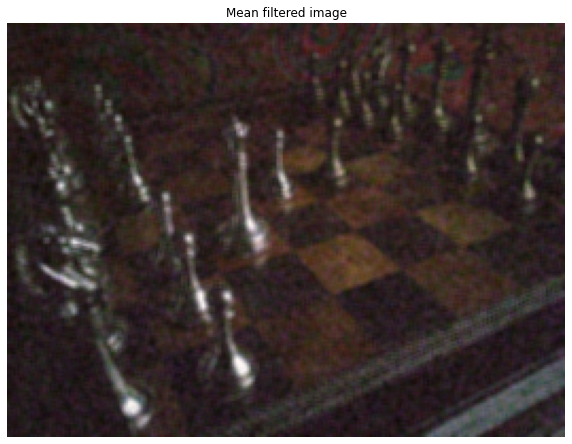

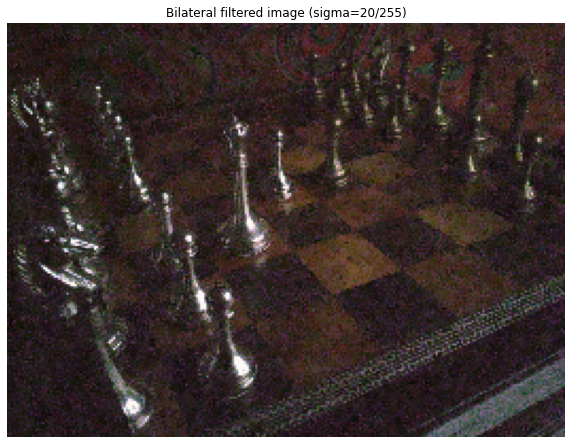

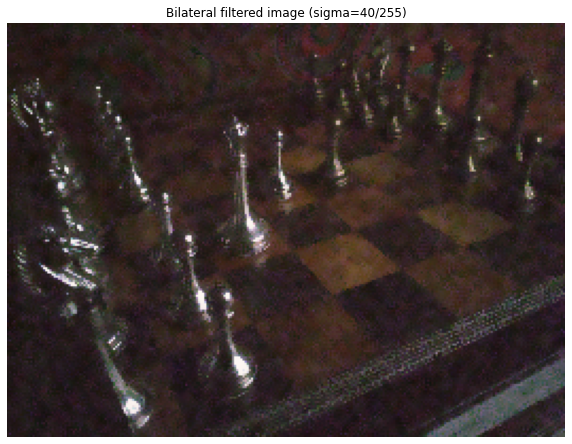

In [346]:
# Example of denoising for the chess image with unknown noise.  Feel free to play with the sigma "guess"
# and other parameters to see if you can improve the qualitative reconstruction
# Reducing the size of the image for faster processing

chess_raw = imread("data/chess.png")

chess_noisy = cv2.resize(chess_raw, (int(chess_raw.shape[1]/4), int(chess_raw.shape[0]/4)))/255.
plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Low-light smartphone image")
plt.imshow(chess_noisy)

mean_filtered_chess = mean_filter(chess_noisy, 3)
bilateral_filtered_chess_20 = bilateral_filter(chess_noisy, sigma=20/255.)
bilateral_filtered_chess_40 = bilateral_filter(chess_noisy, sigma=40/255.)

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Mean filtered image")
plt.imshow(mean_filtered_chess)

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Bilateral filtered image (sigma=20/255)")
plt.imshow(bilateral_filtered_chess_20)

plt.figure(figsize=(10,20))
plt.axis('off')
plt.title("Bilateral filtered image (sigma=40/255)")
plt.imshow(bilateral_filtered_chess_40)

## chess image

It is clear that bilateral filtering performed better than mean filtering. Increasing the standard deviation better reduced the noise, but it seems more details like the texture of the board is missing as well. The trade off is there.